In [82]:
import xarray as xr 
import matplotlib.pyplot as plt
import cmocean as cmo 
import pandas as pd 
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import numpy as np

import matplotlib.dates as mdates

# Start date 
start_date = '2024-08-10'
end_date = pd.to_datetime(start_date) + pd.Timedelta(seconds=(10*9999))
dates = pd.date_range(start_date, end_date, freq='10s')


# python -m ipykernel install --user --name schimpy --display-name Schimpy

In [79]:
# open datasets

truth = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc', decode_timedelta=False)
guess = xr.open_dataset('../forward_phyto/forward_phyto_1.nc', decode_timedelta=False)
hydro = xr.open_dataset('../run_hydro/HYDRO.nc', decode_timedelta=False)
adj   = xr.open_dataset('adjoint_4.nc')


grad = guess["gamma"].values * adj["lambda"].values
z = guess["z"]

In [ ]:
# truth.gamma.values.T

# guess1 = xr.open_dataset("adjoint_2.nc")
# guess2 = xr.open_dataset("adjoint_3.nc")
# guess3 = xr.open_dataset("adjoint_4.nc")

# def difference_(data):
#     s = sum(sum(data.gamma.values.T - truth.gamma.values.T))
#     print(s)
#     return s 

# difference_(guess1)
# difference_(guess2)
# difference_(guess3)

-2.596247046314032


ValueError: operands could not be broadcast together with shapes (60,10000) (60,9999) 

ValueError: operands could not be broadcast together with shapes (60,10000) (60,9999) 

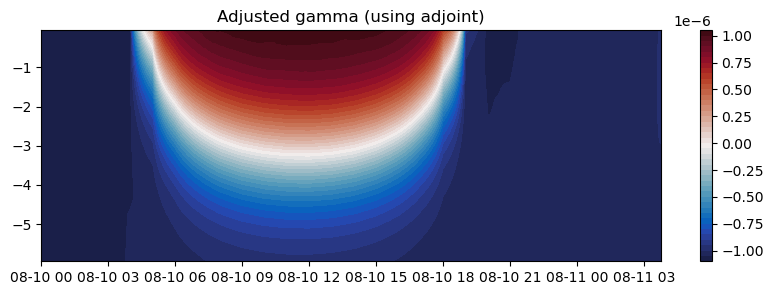

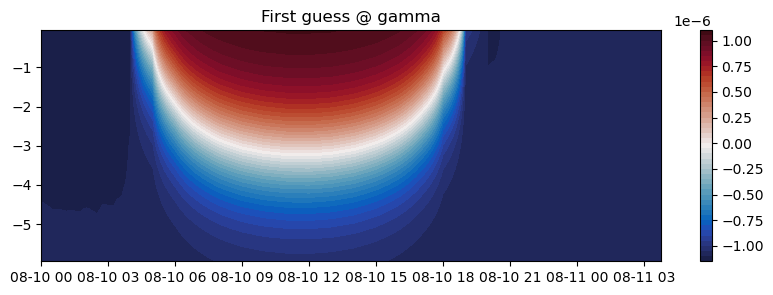

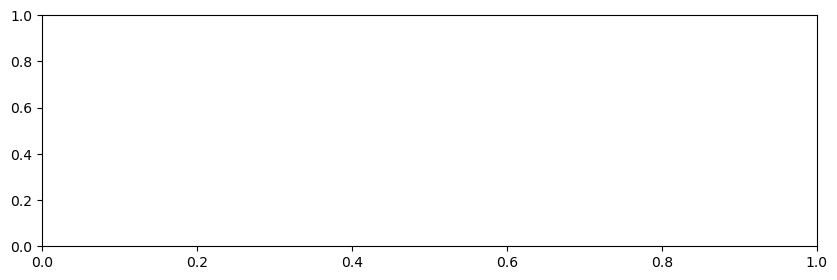

In [83]:
# Contour plots of gamma 
fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, adj.gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Adjusted gamma (using adjoint)')


fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, guess.gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('First guess @ gamma')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
diff = (guess.gamma.values.T - truth.gamma.values.T)
print(np.min(diff), np.max(diff))
c = ax.contourf(dates, -z, diff , levels=50, cmap=cmo.cm.deep_r, vmin=-1.5e-5, vmax=0)
plt.colorbar(c)
plt.title('(Guessed gamma - True gamma)')

Text(0.5, 1.0, '(Guessed gamma - True gamma)')

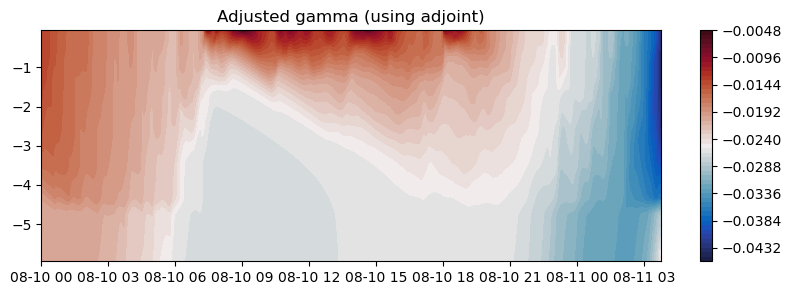

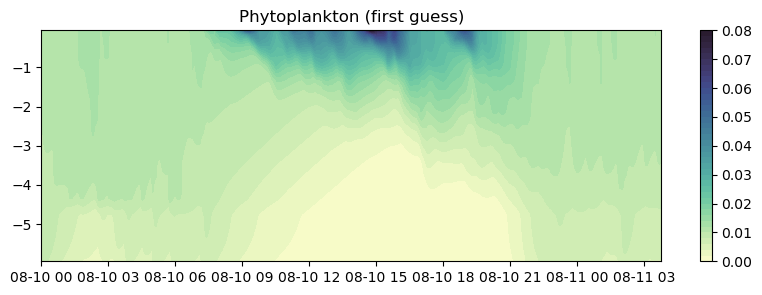

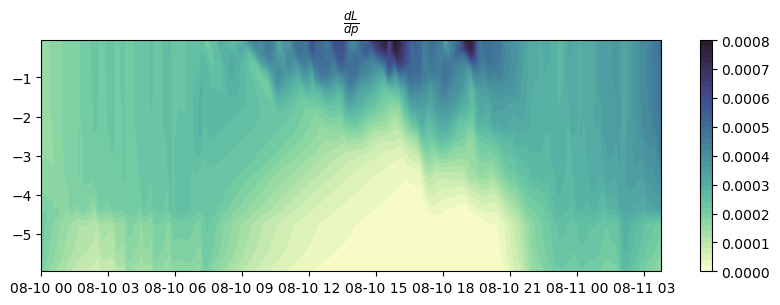

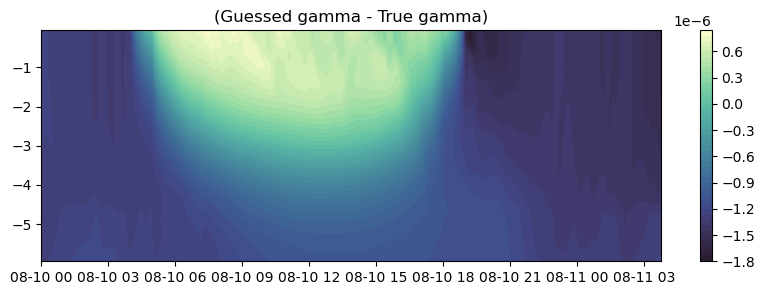

: 

In [ ]:
fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, adj['lambda'].values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Adjusted gamma (using adjoint)')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
c = ax.contourf(dates, -z, guess['algae1'].values.T, levels=50, cmap=cmo.cm.deep)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title('Phytoplankton (first guess)')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
dldp = -(guess['algae1'].values.T * adj['lambda'].values.T)
c = ax.contourf(dates, -z, dldp, levels=50, cmap=cmo.cm.deep)#, vmin=1.5e-7, vmax=1.5e-7)
plt.colorbar(c)
plt.title(r'$\frac{dL}{dp}$')

fig = plt.figure(figsize=(10, 3))
ax = fig.add_subplot(111)
new_gamma = (guess.gamma.values.T - dldp*1e-3)
c = ax.contourf(dates, -z, new_gamma , levels=50, cmap=cmo.cm.deep_r )#, vmin=-1.5e-5, vmax=0)
plt.colorbar(c)
plt.title('(Guessed gamma - True gamma)')

# fig = plt.figure(figsize=(10, 3))
# ax = fig.add_subplot(111)
# c = ax.contourf(dates, -z, guess.gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
# plt.colorbar(c)
# plt.title('First guess @ gamma')

# fig = plt.figure(figsize=(10, 3))
# ax = fig.add_subplot(111)
# c = ax.contourf(dates, -z, truth.gamma.values.T, levels=50, cmap=cmo.cm.balance)#, vmin=1.5e-7, vmax=1.5e-7)
# plt.colorbar(c)
# plt.title('True gamma')

In [29]:
frames = []

start = 0
end = 8998 
spacing = 100 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):

    # print("New guess: ", adj["gamma"][i,-5:-1].values)
    # print("Old guess: ", guess["gamma"][i,-5:-1].values)

    print("Diff: ", (adj["gamma"][i,-5:-1].values-guess["gamma"][i,-5:-1].values))

    h1 = go.Scatter(x=truth["gamma"][i,:], y=-z, name= "Truth", mode='lines', line=dict(width=4, color="blue"))  
    h2 = go.Scatter(x=guess["gamma"][i,:], y=-z, name= "First guess", mode='lines', line=dict(width=4, color="green"))  
    h3 = go.Scatter(x=adj["gamma"][i,:], y=-z, name= "Adjusted guess",  mode='lines', line=dict(width=1, color="red"))  
    frames.append(go.Frame(data=[h1, h2, h3], name=str(dates[i])))

# Initial figure
i = 0 
h1 = go.Scatter(x=guess["gamma"][i,:], y=-z, name= "Guess", mode='lines', line=dict(width=2, color="blue"))  
h2 = go.Scatter(x=truth["gamma"][i,:], y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))  
h3 = go.Scatter(x=adj["gamma"][i,:], y=-z, name= "Adjusted guess",  mode='lines', line=dict(width=1, color="red"))  

fig = go.Figure( data=[h1, h2, h3],
                layout=go.Layout(
                    title='Algae Concentration in the Water Column',
                    xaxis=dict(range=[-2e-6, 2e-6], title='Algae Concentration (cells/mL)'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


Diff:  [0. 0. 0. 0.]
Diff:  [7.72093512e-09 7.71366710e-09 7.70645233e-09 7.69823391e-09]
Diff:  [8.39731266e-09 8.39581039e-09 8.39401014e-09 8.39165790e-09]
Diff:  [8.59003810e-09 8.58812586e-09 8.58573455e-09 8.58243755e-09]
Diff:  [8.85696956e-09 8.85477110e-09 8.85220952e-09 8.84895295e-09]
Diff:  [9.01335296e-09 9.00450934e-09 8.99730040e-09 8.99099553e-09]
Diff:  [9.08052792e-09 9.07703719e-09 9.07324800e-09 9.06876743e-09]
Diff:  [9.10737504e-09 9.08934806e-09 9.07791828e-09 9.06932962e-09]
Diff:  [9.55289201e-09 9.54972637e-09 9.54627269e-09 9.54201714e-09]
Diff:  [1.00041212e-08 9.96497559e-09 9.96034887e-09 9.95742220e-09]
Diff:  [9.91953561e-09 9.85287403e-09 9.84123767e-09 9.83395985e-09]
Diff:  [1.03418573e-08 1.03390420e-08 1.03353851e-08 1.03318272e-08]
Diff:  [1.06006666e-08 1.05973795e-08 1.05930782e-08 1.05889740e-08]
Diff:  [1.08317824e-08 1.08255420e-08 1.08191792e-08 1.08129566e-08]
Diff:  [1.06168431e-08 1.05730116e-08 1.05590361e-08 1.05501257e-08]
Diff:  [7.802

In [35]:
frames = []

start = 0
end = 8998 
spacing = 6 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=guess["algae1"][i,:], y=-z, name= "Guess", mode='lines', line=dict(width=2, color="blue"))  
    h2 = go.Scatter(x=truth["algae1"][i,:], y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))  
    frames.append(go.Frame(data=[h1, h2], name=str(dates[i])))

# Initial figure
i = 0 
h1 = go.Scatter(x=guess["algae1"][i,:], y=-z, name= "Guess", mode='lines', line=dict(width=2, color="blue"))  
h2 = go.Scatter(x=truth["algae1"][i,:], y=-z, name= "Truth",  mode='lines', line=dict(width=2, color="green"))   
fig = go.Figure( data=[h1, h2],
                layout=go.Layout(
                    title='Algae Concentration in the Water Column',
                    xaxis=dict(range=[0, 1e-1], title='Algae Concentration (cells/mL)'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


In [3]:
frames = []

start = 8998
end = 0
spacing = -50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    # print(adj["lambda"][i,:][0:5].values)
    h1 = go.Scatter(x=adj["lambda"][i,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=adj["lambda"][start,:], y=-z, name= "Adjoint", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='Adjoint operator',
                    xaxis=dict(range=[-0.02, 0.02], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


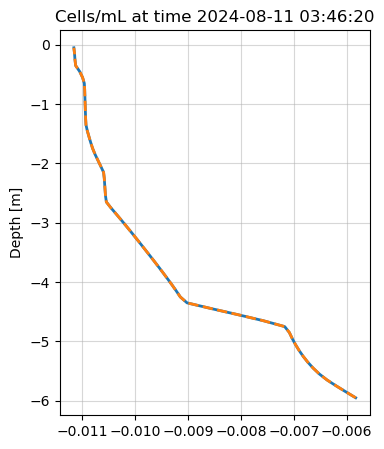

In [4]:

plt.figure(figsize=(4, 5))

i = -1 
diff = guess["algae1"][i,:] - truth["algae1"][i,:]

plt.plot(diff, -z, linewidth=2)
plt.plot(adj["lambda"][i,:]/2 , -z, '--',linewidth=2)
# plt.plot(flip(diff), -z, linewidth=2)
plt.title(f"Cells/mL at time %s" % dates[-1])
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()



In [69]:
# TURBULENT DIFFUSIVITY

frames = []

start = 0
end = 8998
spacing = 50 
times = [dates[i] for i in range(start, end, spacing)]
# Create a frame for each phase shift
for i in range(start, end, spacing):
    h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
    frames.append(go.Frame(data=[h1], name=str(dates[i])))

# Initial figure
h1 = go.Scatter(x=hydro["Kz"][i,:], y=-z, name= "Turbulent Diffusivity", mode='lines', line=dict(width=2, color="blue"))  
fig = go.Figure( data=[h1],
                layout=go.Layout(
                    title='TURBULENT DIFFUSIVITY',
                    xaxis=dict(range=[0, 0.01], title='Adjoint Variable [-]'),
                    yaxis=dict(range=[-6, 0], title='Water Depth (m)'),
                    updatemenus=[{
                    'type': 'buttons',
                    'showactive': False,
                    'buttons': [{
                        'label': 'Play',
                        'method': 'animate',
                        'args': [None, {
                            'frame': {'duration': 200, 'redraw': True},
                            'fromcurrent': True
                        }]
                    }]
                }],
                sliders=[{
                    'active': 0,
                    'steps': [{'label': t.strftime('%b/%d %H:%M'),'method': 'animate', 'args': [[str(t)], {'mode': 'immediate', 'frame': {'duration': 0}, 'transition': {'duration': 0}}]} for t in times]
                }]
            ),
    frames=frames
)
fig.show()


<xarray.Dataset> Size: 5MB
Dimensions:  (z: 60, time: 9999)
Coordinates:
  * z        (z) float32 240B 5.95 5.85 5.75 5.65 5.55 ... 0.35 0.25 0.15 0.05
  * time     (time) timedelta64[ns] 80kB 00:00:01 00:00:02 ... 02:46:38 02:46:39
Data variables:
    lambda   (time, z) float64 5MB ...


/tmp/ipykernel_1299565/2487831615.py:1: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('adjoint.nc')


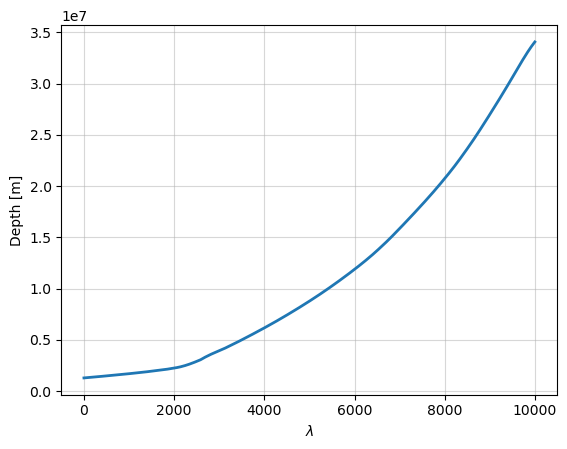

2024-08-10 05:33:00
2024-08-10 05:16:20
2024-08-10 04:59:40
2024-08-10 04:43:00
2024-08-10 04:26:20
2024-08-10 04:09:40
2024-08-10 03:53:00
2024-08-10 03:36:20
2024-08-10 03:19:40
2024-08-10 03:03:00
2024-08-10 02:46:20
2024-08-10 02:29:40
2024-08-10 02:13:00
2024-08-10 01:56:20
2024-08-10 01:39:40
2024-08-10 01:23:00
2024-08-10 01:06:20
2024-08-10 00:49:40
2024-08-10 00:33:00
2024-08-10 00:16:20


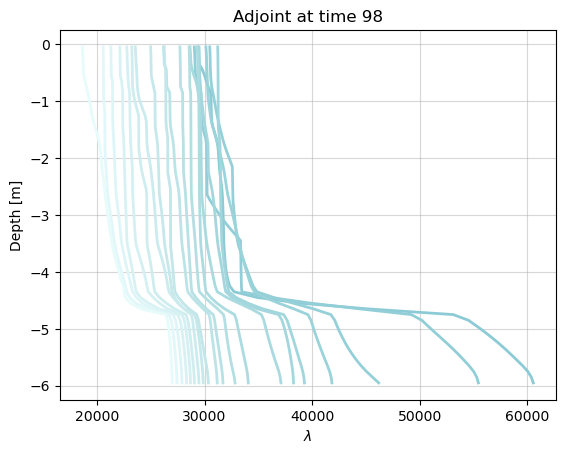

In [ ]:

ds = xr.open_dataset('adjoint.nc')

z = -ds['z'].values
time = ds['time'].values

plt.figure()
plt.plot(ds['lambda'].sum(dim='z'), linewidth=2)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.grid(alpha=0.5)
plt.show()




plt.figure()
for i in range(1998, 0, -100):
    print(dates[i])
    plt.plot(ds['lambda'].isel(time=i), z, color=cmo.cm.ice_r(i/10000), linewidth=2)
    # print("At time %d, sum(lambda) = %f" % (i, ds['lambda'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
# ax.set_xlim(-1e4,1e4)
ax.grid(alpha=0.5)
plt.show()


/tmp/ipykernel_1299565/4253105365.py:6: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')


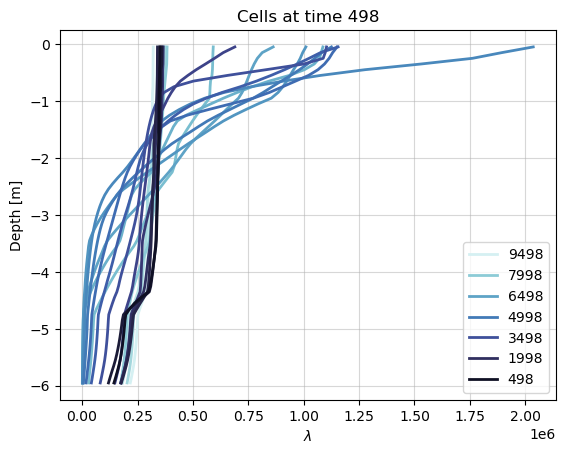

In [40]:
import matplotlib.pyplot as plt
import cmocean as cmo 



ds = xr.open_dataset('../forward_phyto/phyto_TRUTH.nc')

z = ds['z'].values
time = ds['time'].values


plt.figure()
for i in range(9998, 0, -500):
    if i%3 == 0 :
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2, label=i)
    else : 
        plt.plot(ds['algae1'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
plt.title(f"Cells at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.legend()
# ax.set_xlim(0,4)
ax.grid(alpha=0.5)
plt.show()

At time 9998, sum(lambda) = 0.503609
At time 9498, sum(lambda) = 0.251445
At time 8998, sum(lambda) = 0.103097
At time 8498, sum(lambda) = 0.213268
At time 7998, sum(lambda) = 0.164009
At time 7498, sum(lambda) = 0.132224
At time 6998, sum(lambda) = 0.036655
At time 6498, sum(lambda) = 0.009403
At time 5998, sum(lambda) = 0.013678
At time 5498, sum(lambda) = 0.002634
At time 4998, sum(lambda) = 0.004618
At time 4498, sum(lambda) = 0.006982
At time 3998, sum(lambda) = 0.003122
At time 3498, sum(lambda) = 0.009544
At time 2998, sum(lambda) = 0.007737
At time 2498, sum(lambda) = 0.166115
At time 1998, sum(lambda) = 0.126441
At time 1498, sum(lambda) = 0.292678
At time 998, sum(lambda) = 0.359232
At time 498, sum(lambda) = 0.447689


/tmp/ipykernel_1702945/913905150.py:8: FutureWarning: In a future version of xarray decode_timedelta will default to False rather than None. To silence this warning, set decode_timedelta to True, False, or a 'CFTimedeltaCoder' instance.
  ds = xr.open_dataset('../run_hydro/HYDRO.nc')


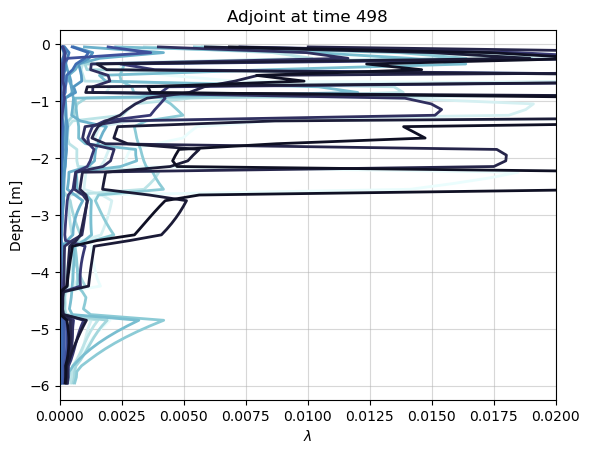

In [ ]:
import matplotlib.pyplot as plt
import cmocean as cmo 

z = ds['z'].values
time = ds['time'].values


ds = xr.open_dataset('../run_hydro/HYDRO.nc')

plt.figure()
for i in range(9998, 0, -200):
    plt.plot(ds['Kz'].isel(time=i), -z, color=cmo.cm.ice(i/10000), linewidth=2)
    print("At time %d, sum(lambda) = %f" % (i, ds['Kz'].isel(time=i).sum()))
plt.title(f"Adjoint at time %d" % i)
plt.xlabel(r'$\lambda$')
plt.ylabel('Depth [m]')
ax = plt.gca()
ax.set_xlim(0,2e-2)
ax.grid(alpha=0.5)
plt.show()